In [0]:
!pip install pandas==0.25.1

In [0]:
!apt install -y libsndfile1 ffmpeg
!pip install musdb
!pip install museval
!pip install -q scikit_posthocs
!pip install librosa

Reading package lists... Done
Building dependency tree       
Reading state information... Done
libsndfile1 is already the newest version (1.0.28-4ubuntu0.18.04.1).
ffmpeg is already the newest version (7:3.4.6-0ubuntu0.18.04.1).
The following package was automatically installed and is no longer required:
  libnvidia-common-430
Use 'apt autoremove' to remove it.
0 upgraded, 0 newly installed, 0 to remove and 32 not upgraded.
     |████████████████████████████████| 92kB 5.8MB/s 
  Created wheel for simplejson: filename=simplejson-3.17.0-cp36-cp36m-linux_x86_64.whl size=114204 sha256=69f2084ccd84b08fbd8dd5f67faa4645483c16785294b15f404cb9980a34c33a
  Stored in directory: /root/.cache/pip/wheels/86/c0/83/dcd0339abb2640544bb8e0938aab2d069cef55e5647ce6e097
Successfully built simplejson


In [0]:
from IPython.display import Audio, display
import urllib.request
import numpy as np
import scipy.stats
import seaborn as sns
import pandas as pd
import scikit_posthocs as sp
import matplotlib.pyplot as plt
from matplotlib import gridspec
from matplotlib.transforms import BlendedGenericTransform
import scikit_posthocs as sp
from urllib.request import urlopen
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

In [0]:
urllib.request.urlretrieve(
    'https://raw.githubusercontent.com/faroit/stempeg/master/stempeg/data/The%20Easton%20Ellises%20-%20Falcon%2069.stem.mp4', 
    'track.stem.mp4')

('track.stem.mp4', <http.client.HTTPMessage at 0x7fb4f333d860>)

We use stempeg to read the file we just downloaded, and put the result in the S variable.

S is the stem tensor that includes the time domain signals scaled to [-1..1]. The shape is (stems, samples, channels).

In [0]:
import stempeg
S, rate = stempeg.read_stems('track.stem.mp4')
print(S.shape)

(5, 265216, 2)


### Playing some audio back

Now that we have obtained the audio array, let's play it back. `S[0]` is the mixture, `S[4]` is the vocals.

In [0]:
print("Mixture")
display(Audio(S[0].T, rate=rate))
print("Vocals")
display(Audio(S[4].T, rate=rate))
print("Drums")
display(Audio(S[1].T, rate=rate))

Mixture


Vocals


Drums


In [0]:
import musdb
mus = musdb.DB(download=True)

In [0]:
track = mus[42]
print(track.name)
display(Audio(track.audio.T, rate=track.rate))

James May - On The Line


In [0]:
track.targets

OrderedDict([('vocals', vocals),
             ('drums', drums),
             ('bass', bass),
             ('other', other),
             ('accompaniment', bass+drums+other),
             ('linear_mixture', vocals+bass+drums+other)])

In [0]:
vocals = track.targets['vocals']
Audio(vocals.audio.T, rate=track.rate)

Display Spectrograms
Spectrograms
Spectrograms are images that give the energy of an audio signal along time and frequency. It's a very useful representation for audio.

Import librosa
We want to go further the analysis, and now we will be computing spectrograms on this song.

For this, let's import the librosa library.



## Display Spectrograms

### Spectrograms

Spectrograms are _images_ that give the _energy_ of an audio signal along time and frequency.
It's a very useful representation for audio.

### Import `librosa`
We want to go further the analysis, and now we will be computing spectrograms on this song.

For this, let's import the `librosa` library.

In [0]:
import librosa,librosa.display

In [0]:
X = librosa.stft(librosa.to_mono(track.audio.T))
S_vocals = np.abs(librosa.stft(librosa.to_mono(track.targets['vocals'].audio.T)))
S_accompaniment = np.abs(librosa.stft(librosa.to_mono(track.targets['accompaniment'].audio.T)))

## Apply Ratio Mask Filtering (Oracle)

### Introduction: reconstruct audio !

Spectrograms are images ! We cannot reconstruct easily audio for them, because we miss the phase information.

However, if we have the spectrograms of all the sources, we may use the mixture and its phase to get good estimates for the sources.
That's what called `oracle filtering` in the jargon. 

Let's separate the vocals this way.

In short, it means keeping only the parts of the mix that are vocals. This is done by applying a *mask* to the mix, which is either 1 (vocals) or 0 (non vocals.). This mask is given by:

$Mask_{vocals}=\frac{S_{vocals}}{S_{vocals}+S_{accompaniment}}$

and is called a *ratio mask*

### Compute the ratio mask

In [0]:
# small epsilon to avoid dividing by zero
eps = np.finfo(np.float).eps

# compute model as the sum of spectrograms
model = eps + np.abs(S_vocals) + np.abs(S_accompaniment)

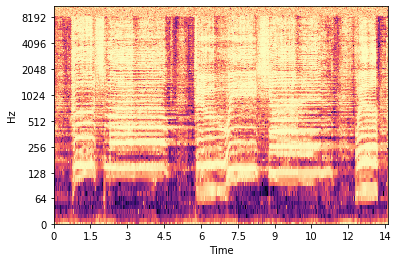

In [18]:
# compute ratio mask as the ratio between source spectrogram and total
Mask_vocals = np.divide(np.abs(S_vocals), model)

librosa.display.specshow(librosa.amplitude_to_db(np.abs(Mask_vocals), ref=np.max), y_axis='log', x_axis='time')

In [0]:
# multiply the mix by the mask
Y_vocals = np.multiply(X, Mask_vocals)

# invert to time domain
vocals_estimate = librosa.istft(Y_vocals)

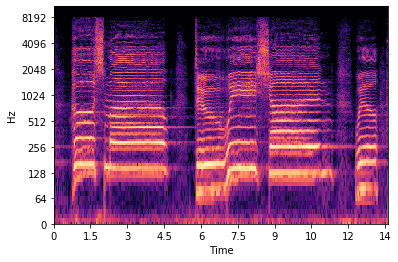

In [21]:
librosa.display.specshow(librosa.amplitude_to_db(np.abs(Y_vocals), ref=np.max), y_axis='log', x_axis='time')
Audio(vocals_estimate, rate=track.rate)

In [22]:
Mask_accompaniment = np.divide(np.abs(S_accompaniment), model)
Y_accompaniment = np.multiply(X, Mask_accompaniment)
accompaniment_estimate = librosa.istft(Y_accompaniment)
Audio(accompaniment_estimate, rate=track.rate)

In [23]:
from scipy.signal import stft, istft
f, t, X = stft(track.audio.T, nperseg=4096, noverlap=3072)
print(X.shape)
t, audio = istft(X, track.rate, nperseg=4096, noverlap=3072)

(2, 2049, 294)


In [25]:
import torch
# small epsilon to avoid dividing by zero
eps = np.finfo(np.float).eps

# compute STFT of Mixture
N = track.audio.shape[0]  # remember number of samples for future use
X = stft(track.audio.T, nperseg=4096, noverlap=3072)[-1]
(I, F, T) = X.shape

# Compute sources spectrograms
P = {}
# compute model as the sum of spectrograms
model = eps

for name, source in track.sources.items():
    # compute spectrogram of target source:
    unmix = torch.hub.load('sigsep/open-unmix-pytorch', model='umx', target=name)
    P[name] = unmix(torch.tensor(track.audio.T[None, ...]).float()).detach().numpy()[:, 0, ...].transpose(1, 2, 0)
#     P[name] = np.abs(stft(source.audio.T, nperseg=4096, noverlap=3072)[-1])
    model += P[name]

# now performs separation
estimates = {}
for name, source in track.sources.items():
    # compute soft mask as the ratio between source spectrogram and total
    Mask = P[name] / model

    # multiply the mix by the mask
    Yj = Mask * X

    # invert to time domain
    target_estimate = istft(Yj, nperseg=4096, noverlap=3072)[1].T

    # set this as the source estimate
    estimates[name] = target_estimate

Using cache found in /root/.cache/torch/hub/sigsep_open-unmix-pytorch_master
Using cache found in /root/.cache/torch/hub/sigsep_open-unmix-pytorch_master
Using cache found in /root/.cache/torch/hub/sigsep_open-unmix-pytorch_master
Using cache found in /root/.cache/torch/hub/sigsep_open-unmix-pytorch_master


In [26]:
for target, estimate in estimates.items():
  display(Audio(estimate.T, rate=track.rate))

In [27]:
mus = musdb.DB(download=True, subsets='train')

for track in mus:
    print(track.name)

A Classic Education - NightOwl
ANiMAL - Clinic A
ANiMAL - Easy Tiger
ANiMAL - Rockshow
Actions - Devil's Words
Actions - One Minute Smile
Actions - South Of The Water
Aimee Norwich - Child
Alexander Ross - Goodbye Bolero
Alexander Ross - Velvet Curtain
Angela Thomas Wade - Milk Cow Blues
Atlantis Bound - It Was My Fault For Waiting
Auctioneer - Our Future Faces
AvaLuna - Waterduct
BigTroubles - Phantom
Bill Chudziak - Children Of No-one
Black Bloc - If You Want Success
Celestial Shore - Die For Us
Chris Durban - Celebrate
Clara Berry And Wooldog - Air Traffic
Clara Berry And Wooldog - Stella
Clara Berry And Wooldog - Waltz For My Victims
Cnoc An Tursa - Bannockburn
Creepoid - OldTree
Dark Ride - Burning Bridges
Dreamers Of The Ghetto - Heavy Love
Drumtracks - Ghost Bitch
Faces On Film - Waiting For Ga
Fergessen - Back From The Start
Fergessen - Nos Palpitants
Fergessen - The Wind
Flags - 54
Giselle - Moss
Grants - PunchDrunk
Helado Negro - Mitad Del Mundo
Hezekiah Jones - Borrowed Hear

In [0]:
%%capture
!apt install -y libsndfile1 ffmpeg
!pip install musdb
!pip install tqdm
!pip install norbert

In [1]:
import torch
print("GPU available:", torch.cuda.is_available())

GPU available: True


In [2]:
!git clone https://github.com/sigsep/open-unmix-pytorch.git
%cd open-unmix-pytorch/

Cloning into 'open-unmix-pytorch'...
remote: Enumerating objects: 18, done.
remote: Counting objects: 100% (18/18), done.
remote: Compressing objects: 100% (16/16), done.
remote: Total 1592 (delta 7), reused 5 (delta 2), pack-reused 1574
Receiving objects: 100% (1592/1592), 333.36 KiB | 608.00 KiB/s, done.
Resolving deltas: 100% (1032/1032), done.
/content/open-unmix-pytorch


In [0]:
import scipy.signal
from IPython.display import Audio, display
import numpy as np
from tqdm import tnrange, tqdm_notebook
import matplotlib.pyplot as plt
from matplotlib import gridspec
import warnings
import random
import sklearn.preprocessing
import norbert
import musdb
warnings.simplefilter(action='ignore', category=FutureWarning)

In [0]:
import torch.utils
import torch
import torch.utils.data

class SimpleMUSDBDataset(torch.utils.data.Dataset):
    def __init__(
        self,
        subset='train',
        split='train',
        target='vocals',
        seq_duration=None,
    ):
        """MUSDB18 Dataset wrapper
        """
        self.seq_duration = seq_duration
        self.target = target
        self.mus = musdb.DB(
            download=True,
            split=split,
            subsets=subset,
        )

    def __getitem__(self, index):
        track = self.mus[index]
        track.chunk_start = random.uniform(0, track.duration - self.seq_duration)
        track.chunk_duration = self.seq_duration
        x = track.audio.T
        y = track.targets[self.target].audio.T
        return torch.tensor(x, dtype=torch.float32), torch.tensor(y, dtype=torch.float32)


    def __len__(self):
        return len(self.mus)

In [9]:
train_dataset = SimpleMUSDBDataset(seq_duration=5.0)
train_sampler = torch.utils.data.DataLoader(train_dataset, batch_size=8, shuffle=True)
print(len(train_dataset))

Done!
80


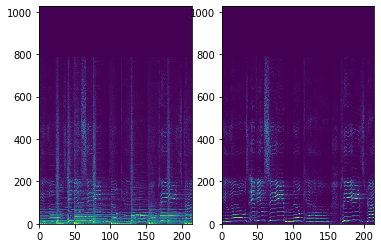

In [10]:
import model
import torch.nn as nn

# create a spectrogram layer
stft = model.STFT(n_fft=2048, n_hop=1024)
spec = model.Spectrogram(mono=True)
transform = nn.Sequential(stft, spec)

x, y = train_dataset[7]

# transform the time domain input to spectrograms
X = transform(x[None])
Y = transform(y[None])

f, axes = plt.subplots(1, 2)
axes[0].pcolormesh(np.log(X[:, 0, 0, :].detach().numpy().T + 1))
axes[1].pcolormesh(np.log(Y[:, 0, 0, :].detach().numpy().T + 1))

display(Audio(x, rate=44100))
display(Audio(y, rate=44100))

In [11]:
scaler = sklearn.preprocessing.StandardScaler()

for x, y in tqdm_notebook(train_dataset):
    X = transform(x[None])
    scaler.partial_fit(X.squeeze().numpy())

# set inital input scaler values
scale = np.maximum(
    scaler.scale_,
    1e-4*np.max(scaler.scale_)
)
mean = scaler.mean_

In [0]:
use_cuda = torch.cuda.is_available()
torch.manual_seed(42)

device = torch.device("cuda" if use_cuda else "cpu")
kwargs = {'num_workers': 1, 'pin_memory': True} if use_cuda else {}

In [0]:
import torch.optim as optim

unmix = model.OpenUnmix(
    input_mean=mean,
    input_scale=scale,
    nb_channels=1,
    hidden_size=256,
    n_fft=2048,
    n_hop=1024,
    max_bin=64,
    sample_rate=44100
).to(device)
    
optimizer = optim.RMSprop(unmix.parameters(), lr=0.001)
criterion = torch.nn.MSELoss()

In [15]:
import utils
losses = utils.AverageMeter()
unmix.train()

for i in tqdm_notebook(range(50)):
    for x, y in tqdm_notebook(train_sampler):
        x, y = x.to(device), y.to(device)
        optimizer.zero_grad()
        Y_hat = unmix(x)
        Y = unmix.transform(y)
        loss = torch.nn.functional.mse_loss(Y_hat, Y)
        loss.backward()
        optimizer.step()
        losses.update(loss.item(), Y.size(1))
    print(losses.avg)

2.4115007400512694


2.3497542262077333


2.3194081862767537


2.249498742818832


2.195308542251587


2.1359167814254763


2.084541749954224


2.04876322299242


2.01554028722975


1.9830449259281158


1.9615397464145314


1.9329639971256256


1.8985120865014884


1.8661556635584151


1.8419205713272095


1.821041014790535


1.7984454554669997


1.773094128900104


1.748268113010808


1.723414750099182


1.7028338574227833


1.6845218441703103


1.6658354269421618


1.6482271095116934


1.6297960288524627


1.611084475196325


1.5941454150058605


1.5795529640146664


1.562853201298878


1.5431686568260192


1.524716172679778


1.5111724264919757


1.4964172191692122


1.4796144441646688


1.4635612773895263


1.4467260867357254


1.4311240060909374


1.4177707408603868


1.4025514009671334


1.3880034856498242


1.376579284813346


1.3642528149343671


1.350915502808815


1.3387295338240537


1.3262132737371657


1.3147114735582601


1.3038593203463453


1.2923544798046351


1.2806539732582716


1.269328833937645


In [0]:
import musdb
mus = musdb.DB(download=True, subsets='test')
track = mus[1]
def istft(X, rate=44100, n_fft=4096, n_hopsize=1024):
    t, audio = scipy.signal.istft(
        X / (n_fft / 2),
        rate,
        nperseg=n_fft,
        noverlap=n_fft - n_hopsize,
        boundary=True
    )
    return audio
    unmix.stft.center = True
unmix.eval()

audio_torch = torch.tensor(track.audio.T[None, ...]).float().to(device)

Vj = unmix(audio_torch).cpu().detach().numpy()

# compute STFT
X = unmix.stft(audio_torch).detach().cpu().numpy()
# convert to complex numpy
X = X[..., 0] + X[..., 1]*1j
X = X[0].transpose(2, 1, 0)

V = Vj[:, 0, ...].transpose(0, 2, 1)[..., None]
V = norbert.residual_model(V, X)
Y = norbert.wiener(V, X.astype(np.complex128), iterations=2)
estimates = {}
for j, name in enumerate(['vocals', 'accompaniment']):
    audio_hat = istft(
        Y[..., j].T,
        n_fft=unmix.stft.n_fft,
        n_hopsize=unmix.stft.n_hop
    )
    estimates[name] = audio_hat.T

In [18]:
for target, estimate in estimates.items():
    print(target)
    display(Audio(estimate.T, rate=track.rate))

vocals


accompaniment


In [0]:
%%capture
!pip install musdb
!pip install norbert
!pip install librosa
!pip install youtube-dl
!git clone https://github.com/sigsep/open-unmix-pytorch.git

In [0]:
import torch
import numpy as np
import scipy
import librosa
import youtube_dl
import os
import soundfile as sf
from google.colab import files
from IPython.display import Audio, display

use_cuda = torch.cuda.is_available()
device = torch.device("cuda" if use_cuda else "cpu")

In [22]:
%cd open-unmix-pytorch/
import test

/content/open-unmix-pytorch/open-unmix-pytorch


In [23]:
import musdb
mus = musdb.DB(download=True, subsets='test')

track = mus[49]
print(track.name)
display(Audio(track.audio.T, rate=track.rate))

Zeno - Signs


In [24]:
estimates = test.separate(
    audio=track.audio, 
    targets=['vocals', 'drums', 'bass', 'other'], 
    residual_model=False,
    niter=1,
    device=device
)
for target, estimate in estimates.items():
    print(target)
    display(Audio(estimate.T, rate=track.rate))
    

100%|██████████| 4/4 [00:31<00:00,  8.09s/it]


vocals


drums


bass


other


In [25]:
estimates = test.separate(
    audio=track.audio, 
    targets=['vocals'], 
    residual_model=True,
    device=device
)
for target, estimate in estimates.items():
    print(target)
    display(Audio(estimate.T, rate=track.rate))

100%|██████████| 1/1 [00:00<00:00,  4.70it/s]


vocals


accompaniment


In [26]:
estimates = test.separate(
    audio=track.audio, 
    targets=['vocals', 'drums', 'bass', 'other'], 
    residual_model=True,
    device=device
)
print('vocals')
display(Audio(estimates['vocals'].T, rate=track.rate))
acc = np.sum(
    [audio for target, audio in estimates.items() if not target=='vocals'],
    axis=0
)
print('accompaniment')
display(Audio(acc.T, rate=track.rate))

100%|██████████| 4/4 [00:00<00:00,  4.75it/s]


vocals


accompaniment


In [27]:
from IPython.display import HTML
url = "xwtdhWltSIg" #@param {type:"string"}
start = 60 #@param {type:"number"}
stop = 90 #@param {type:"number"}
embed_url = "https://www.youtube.com/embed/%s?rel=0&start=%d&end=%d&amp;controls=0&amp;showinfo=0" % (url, start, stop)
HTML('<iframe width="560" height="315" src=' + embed_url + 'frameborder="0" allowfullscreen></iframe>')

In [0]:
def my_hook(d):
    if d['status'] == 'finished':
        print('Done downloading...')


ydl_opts = {
    'format': 'bestaudio/best',
    'postprocessors': [{
        'key': 'FFmpegExtractAudio',
        'preferredcodec': 'wav',
        'preferredquality': '44100',
    }],
    'outtmpl': '%(title)s.wav',
    'progress_hooks': [my_hook],
}
with youtube_dl.YoutubeDL(ydl_opts) as ydl:
    info = ydl.extract_info(url, download=False)
    status = ydl.download([url])

audio, rate = librosa.load(info.get('title', None) + '.wav', sr=44100, mono=False)
audio = audio[:, start*rate:stop*rate]
print(audio.shape)
display(Audio(audio, rate=rate))
estimates = test.separate(audio=audio.T, targets=['vocals', 'drums', 'bass', 'other'], device=device, residual_model=False)
for target, estimate in estimates.items():
    print(target)
    display(Audio(estimate.T, rate=rate))

In [0]:
for target, estimate in estimates.items():
    sf.write(target + '.wav', estimate, 44100, subtype='PCM_16')
    files.download(target + '.wav')

# Separate from uploaded file

In [0]:
from google.colab import files
uploaded = files.upload()


# Export estimates

After separation, you can save the results as wav files or STEMs.

## Download Separations to disk

In [0]:
for target, estimate in estimates.items():
    sf.write(target + '.wav', estimate, 44100, subtype='PCM_16')
    files.download(target + '.wav')

## Encode to STEMS format

In [0]:
import stempeg
S = np.array([array for array in estimates.values()])
stempeg.write_stems(S, "umx.stem.m4a", rate=44100)
files.download("umx.stem.m4a")

In [0]:
start = 0 #@param {type:"number"}
stop = 15 #@param {type:"number"}
audio, rate = librosa.load(
    list(uploaded.keys())[0],
    sr=44100,
    offset=start,
    duration=stop-start,
    mono=False
)
display(Audio(audio, rate=rate))
estimates = test.separate(
    audio=audio.T,
    targets=['vocals', 'drums', 'bass', 'other'],
    residual_model=False,
    device=device,
    niter=1
)
for target, estimate in estimates.items():
    print(target)
    display(Audio(estimate.T, rate=rate))